<a href="https://colab.research.google.com/github/EladBenjo/Data-Science-Workshop-2025a/blob/main/fed_speeches_draft.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Intro

# Import Data

In [ ]:
import sqlite3
import pandas as pd
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Connect to the SQL database
db_path = '/content/drive/MyDrive/Colab Notebooks/fed_speeches_1996_2025.db'
conn = sqlite3.connect(db_path)

# Load the table into a DataFrame
query = "SELECT * FROM speeches;"
speeches_df = pd.read_sql_query(query, conn)

# Display basic information about the dataset
print("Dataset Overview:")
print(speeches_df.info())

Dataset Overview:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1796 entries, 0 to 1795
Data columns (total 9 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   id           1796 non-null   int64 
 1   speech_date  1796 non-null   object
 2   title        1796 non-null   object
 3   speaker      1796 non-null   object
 4   event        1796 non-null   object
 5   link         1796 non-null   object
 6   speech_text  1792 non-null   object
 7   scrape_date  1796 non-null   object
 8   processed    1796 non-null   int64 
dtypes: int64(2), object(7)
memory usage: 126.4+ KB
None


## Data Cleaning and preparation

In [ ]:
from datetime import datetime

# Convert 'speech_date' to datetime objects
try:
    speeches_df['speech_date'] = pd.to_datetime(speeches_df['speech_date'])

except Exception as e:
    print(f"\nError converting 'speech_date' to datetime: {e}")

### handling missing values of speech_text

In [ ]:
missing_values_rows = speeches_df[speeches_df['speech_text'].isnull()]

,id,speech_date,title,speaker,event,link,speech_text,scrape_date,processed


In [ ]:
# Print the 'link' column for rows with missing 'speech_text'
if not missing_values_rows.empty:
    print("\nLinks for rows with missing 'speech_text':")
    for link in missing_values_rows['link']:
        print(link)
else:
    print("\nNo rows with missing 'speech_text' found.")



Links for rows with missing 'speech_text':
https://www.federalreserve.gov/boarddocs/speeches/2003/20031113/default.htm
https://www.federalreserve.gov/boarddocs/speeches/2003/20031029/default.htm
https://www.federalreserve.gov/boarddocs/speeches/2005/20051128/default.htm
https://www.federalreserve.gov/newsevents/bowman-starling-insights-20240213.htm


In [ ]:
import os

texts = []
indices = []

for index, row in missing_values_rows.iterrows():
    num = str(row['id'])
    file_path = os.path.join('/content/drive/MyDrive/Colab Notebooks/', f"text_{num}.txt")

    if os.path.exists(file_path):
        try:
            with open(file_path, 'r', encoding='utf-8', errors='ignore') as file:
                texts.append(file.read())
                indices.append(index)
        except Exception as e:
            print(f"Error processing id {num}: {e}")
    else:
        print(f"File not found for id: {num}")

speeches_df.loc[indices, 'speech_text'] = texts


In [ ]:
speeches_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1796 entries, 0 to 1795
Data columns (total 9 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   id           1796 non-null   int64         
 1   speech_date  1796 non-null   datetime64[ns]
 2   title        1796 non-null   object        
 3   speaker      1796 non-null   object        
 4   event        1796 non-null   object        
 5   link         1796 non-null   object        
 6   speech_text  1796 non-null   object        
 7   scrape_date  1796 non-null   object        
 8   processed    1796 non-null   int64         
dtypes: datetime64[ns](1), int64(2), object(6)
memory usage: 126.4+ KB


### handling confused records

In [ ]:
# Filter rows where 'speaker' starts with 'at'
invalid_speakers = speeches_df[speeches_df['speaker'].str.startswith('At', na=False)]

# Display the rows with invalid 'speaker' values
invalid_speakers

,id,speech_date,title,speaker,event,link,speech_text,scrape_date,processed
819,820,2008-05-13,Liquidity Provision by the Federal Reserve,At the Risk Transfer Mechanisms and Financial ...,Chairman Bernanke presented identical remarks ...,https://www.federalreserve.gov/newsevents/spee...,Chairman Bernanke presented identical remarks ...,2025-01-06,1
875,876,2009-08-21,Reflections on a Year of Crisis,"At the Brookings Institution's Conference on ""...",Chairman Bernanke delivered the same remarks a...,https://www.federalreserve.gov/newsevents/spee...,Chairman Bernanke delivered the same remarks a...,2025-01-06,1


In [ ]:
# Define the condition for the faulty rows (e.g., those starting with 'at')
condition = speeches_df['speaker'].str.startswith('At', na=False)

# Swap the values of 'speaker' and 'event' for the faulty rows
speeches_df.loc[condition, ['speaker', 'event']] = speeches_df.loc[condition, ['event', 'speaker']].values

In [ ]:
# Overwrite the 'speaker' value completely for rows where it contains 'Chairman Bernanke'
speeches_df.loc[speeches_df['speaker'].str.contains('Chairman Bernanke', na=False), 'speaker'] = 'Chairman Ben S. Bernanke'


### add role column

In [ ]:
# Add a new column 'role' based on the 'speaker' column
def assign_role(speaker):
    if 'Vice Chair' in speaker:
        return 'Vice Chairman'
    elif 'Chairman' in speaker:
        return 'Chairman'
    elif 'Chair' in speaker:
        return 'Chairman'
    elif 'Governor' in speaker:
        return 'Governor'
    else:
        return 'Other'

# Apply the function to create the 'role' column
speeches_df['role'] = speeches_df['speaker'].apply(assign_role)

# Verify the new column
print(speeches_df[['speaker', 'role']].head())

                          speaker           role
0      Vice Chair Alice M. Rivlin  Vice Chairman
1         Chairman Alan Greenspan       Chairman
2         Chairman Alan Greenspan       Chairman
3  Governor Edward W. Kelley, Jr.       Governor
4      Governor Susan M. Phillips       Governor


remove the role from the speakers name

In [ ]:
# Define a function to remove specific words from the 'speaker' column
def remove_titles(speaker):
    # List of words to remove
    words_to_remove = ['Vice Chairman', 'Vice Chair', 'Chairman','Chair','Governor']
    for word in words_to_remove:
        speaker = speaker.replace(word, '').strip()  # Replace and strip any extra spaces
    return speaker

# Apply the function to the 'speaker' column
speeches_df['speaker'] = speeches_df['speaker'].apply(remove_titles)

# Verify the changes
print(speeches_df['speaker'].head())

0          Alice M. Rivlin
1           Alan Greenspan
2           Alan Greenspan
3    Edward W. Kelley, Jr.
4        Susan M. Phillips
Name: speaker, dtype: object


there is only one record where the role is "other", we can get rid of it:

In [ ]:
unique_roles = speeches_df['role'].unique()
unique_roles

array(['Vice Chairman', 'Chairman', 'Governor', 'Other'], dtype=object)

In [ ]:
speeches_df = speeches_df[speeches_df['role'] != "Other"]

In [ ]:
unique_roles = speeches_df['role'].unique()
unique_roles

array(['Vice Chairman', 'Chairman', 'Governor'], dtype=object)

### create speech length column

In [ ]:
# Analyze speech_text: calculate the length of each speech (in words)
speeches_df['speech_length'] = speeches_df['speech_text'].str.split().str.len()
# Display statistics for speech length
print("\nSpeech Length Statistics:")
speeches_df['speech_length'].describe()


Speech Length Statistics:


,speech_length
count,1795.000000
mean,3006.159889
std,1425.322710
min,15.000000
25%,2114.000000
50%,2976.000000
75%,3746.000000
max,14132.000000


the min length looking like another broken record, let's take a look:

In [ ]:
# Sort the dataframe by speech_length in ascending order and select the top 10
shortest_speeches = speeches_df.sort_values('speech_length').head(10)

# Display the id, speech_length and speech_text for the 10 shortest speeches
print(shortest_speeches[['id', 'speech_length', 'speech_text']])

        id  speech_length                                        speech_text
1595  1596             15  View speech charts and figures\n"Some Benefits...
416    417            126  Central Bank Talk: Does it Matter and Why?\n\r...
640    641            168  Vice President Papademos, ladies and gentlemen...
919    920            283  Financial education helps young people cultiva...
1468  1469            303  Good afternoon everyone. I greatly appreciate ...
1192  1193            325  On behalf of the Federal Reserve System, I wan...
429    430            342  Thank you, Tom.  On behalf of the Federal Rese...
1464  1465            379  This will be the 15th Fed Listens event the Fe...
1506  1507            391  Nearly three years after we started holding Fe...
889    890            393  Distinguished guests, I would like to welcome ...


I had to manually look into these records again, and I was able to find few that won't be useful due to missing content, or broken web pages, let's adjust:

In [ ]:
ids_to_remove = [417, 641, 920, 1596]
speeches_df = speeches_df[~speeches_df['id'].isin(ids_to_remove)]

### sort and wrap-up

In [ ]:
# Sort the DataFrame by the 'date' column
speeches_df = speeches_df.sort_values(by='speech_date')

In [ ]:
speeches_df = speeches_df.drop(columns=['id', 'title', 'event', 'link', 'scrape_date', 'processed'])

In [ ]:
speeches_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1791 entries, 0 to 1790
Data columns (total 5 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   speech_date    1791 non-null   datetime64[ns]
 1   speaker        1791 non-null   object        
 2   speech_text    1791 non-null   object        
 3   role           1791 non-null   object        
 4   speech_length  1791 non-null   int64         
dtypes: datetime64[ns](1), int64(1), object(3)
memory usage: 70.1+ KB


all set and ready to proceed to the next step

# Sentiment Analysis

In [ ]:
pip install transformers torch numpy pandas

since our data is 'raw' and not tagged or anything, and in order to get better insights I will use 'FinBert' to iterate through the text and tag it with the overall sentiment.

## text prep

In [ ]:
import re

# Function to clean text
def clean_text(text):
    text = text.strip()  # Remove leading/trailing spaces
    text = re.sub(r'\s+', ' ', text)  # Replace multiple spaces/newlines with a single space
    text = text.replace('\n', ' ').replace('\t', ' ')  # Remove explicit newlines and tabs
    return text

# Apply cleaning to speech_text column
speeches_df['speech_text'] = speeches_df['speech_text'].apply(clean_text)

## FinBert process

### methods

### imports

In [ ]:
import torch
from transformers import AutoTokenizer, AutoModelForSequenceClassification, pipeline
import numpy as np
from tqdm import tqdm  # Progress bar for large datasets

In [ ]:
# Load FinBERT model and tokenizer
model_name = "ProsusAI/finbert"
tokenizer = AutoTokenizer.from_pretrained(model_name)
model = AutoModelForSequenceClassification.from_pretrained(model_name)
sentiment_pipeline = pipeline("text-classification", model=model, tokenizer=tokenizer)

def split_text_into_chunks(text, max_tokens=512, overlap=100):
    """
    Splits long text into chunks of max 512 tokens each.
    """
    tokens = tokenizer.encode(text, add_special_tokens=True)  # Encode text properly
    chunks = []
    start = 0
    while start < len(tokens):
        end = start + max_tokens
        chunk = tokens[start:end]
        chunks.append(chunk)
        start += max_tokens - overlap  # Maintain overlap for context
    return chunks

Device set to use cpu


### execute

In [ ]:
def analyze_speech_sentiment(text):
    """
    Runs FinBERT on speech chunks, enforces 512-token limit, and aggregates sentiment scores.
    """
    chunks = split_text_into_chunks(text)
    sentiments = []

    for chunk in chunks:
        # Convert chunk back to text
        chunk_text = tokenizer.decode(chunk, skip_special_tokens=True)

        # Run FinBERT sentiment analysis
        sentiment = sentiment_pipeline(chunk_text[:512])[0]  # Enforce strict truncation
        sentiments.append(sentiment)

    # Convert sentiments to numerical scores
    sentiment_map = {"positive": 1, "neutral": 0, "negative": -1}
    scores = [sentiment_map[s["label"]] for s in sentiments]

    avg_sentiment = np.mean(scores)  # Aggregate sentiment score
    return avg_sentiment  # Store only the aggregated score

# Apply FinBERT sentiment analysis to each speech (with progress bar)
tqdm.pandas()
speeches_df['sentiment_score'] = speeches_df['speech_text'].progress_apply(analyze_speech_sentiment)

# Save results
speeches_df.to_csv("fed_speeches_with_sentiment.csv", index=False)

# Display result
speeches_df.head()

100%|██████████| 1791/1791 [2:10:01<00:00,  4.36s/it]


,speech_date,speaker,speech_text,role,speech_length,sentiment_score
0,1996-06-13,Alan Greenspan,I am honored to present the William Taylor Mem...,Chairman,3160,0.200000
1,1996-06-18,"Edward W. Kelley, Jr.",It is a pleasure to be here this afternoon to ...,Governor,2639,0.125000
2,1996-09-08,Laurence H. Meyer,Monetary Policy Objectives and Strategy I want...,Governor,2879,-0.111111
3,1996-09-19,Alan Greenspan,You have heard many points of view today on el...,Chairman,1922,0.000000
4,1996-10-02,Lawrence B. Lindsey,Small Business Is Big Business It is my pleasu...,Governor,2195,0.428571


we have our sentiment score, now we can proceed to look into our data and see whta insights we can extract from it.

# EDA

## imports and review

In [ ]:
import matplotlib.pyplot as plt
import altair as alt

In [ ]:
speeches_df.head()

,speech_date,speaker,speech_text,role,speech_length,sentiment_score,year
0,1996-06-13,Alan Greenspan,I am honored to present the William Taylor Mem...,Chairman,3160,0.200000,1996
1,1996-06-18,"Edward W. Kelley, Jr.",It is a pleasure to be here this afternoon to ...,Governor,2639,0.125000,1996
2,1996-09-08,Laurence H. Meyer,Monetary Policy Objectives and Strategy I want...,Governor,2879,-0.111111,1996
3,1996-09-19,Alan Greenspan,You have heard many points of view today on el...,Chairman,1922,0.000000,1996
4,1996-10-02,Lawrence B. Lindsey,Small Business Is Big Business It is my pleasu...,Governor,2195,0.428571,1996


## general EDA

In [ ]:
# Create an Altair histogram of sentiment scores
chart = alt.Chart(speeches_df).mark_bar().encode(
    alt.X('sentiment_score:Q', bin=alt.Bin(maxbins=30), title="Sentiment Score"),
    alt.Y('count()', title="Count"),
    tooltip=[alt.X('sentiment_score:Q', bin=alt.Bin(maxbins=30)), alt.Y('count()')]
).properties(
    title="Distribution of Speech Sentiment Scores",
    width=800,
    height=400
)

# Display the chart
chart


alt.Chart(...)

now let's inspects trends over time, and also mark major economic events on the graphs.

In [ ]:
crisis_years = pd.DataFrame({
    'year': [2001, 2008, 2020],
    'event': ["Dot-com Bubble", "2008 Financial Crisis", "COVID-19"]
})
# event lines
crisis_lines = alt.Chart(crisis_years).mark_rule(color='red', strokeWidth=2, strokeDash=[5,5]).encode(
    x='year:O'
)

# event labels
crisis_labels = alt.Chart(crisis_years).mark_text(align='left', dx=5, dy=-10, color='red').encode(
    x='year:O',
    y=alt.value(350),
    text='event'
)


In [ ]:
# Compute average sentiment per year
yearly_sentiment = speeches_df.groupby('year', as_index=False)['sentiment_score'].mean()

# Create a line chart
chart = alt.Chart(yearly_sentiment).mark_line(point=True).encode(
    x=alt.X('year:O', title='Year'),  # Treat year as ordinal
    y=alt.Y('sentiment_score:Q', title='Average Sentiment Score'),
    tooltip=['year', alt.Tooltip('sentiment_score:Q', format='.3f', title='Avg Sentiment')]
).properties(
    title="Federal Reserve Speech Sentiment Over Time",
    width=800,
    height=400
).interactive()

# Display the chart
chart + crisis_lines + crisis_labels


alt.LayerChart(...)

In [129]:
# Convert sentiment scores to categorical labels
def categorize_sentiment(score):
    if score > 0.1:
        return "Positive"
    elif score < -0.1:
        return "Negative"
    else:
        return "Neutral"

# Apply sentiment categorization
speeches_df['Market Sentiment'] = speeches_df['sentiment_score'].apply(categorize_sentiment)

# Group by year and sentiment to get counts
yearly_sentiment_counts = speeches_df.groupby(['year', 'Market Sentiment']).size().reset_index(name='count')

# Calculate percentages within each year
yearly_sentiment_counts['percentage'] = yearly_sentiment_counts.groupby('year')['count'].transform(lambda x: x / x.sum() * 100)

# Create the stacked bar chart with percentage labels
bars = alt.Chart(yearly_sentiment_counts).mark_bar().encode(
    x=alt.X('year:O', title='Year'),  # Treating year as ordinal for better display
    y=alt.Y('sum(count):Q', title='Number of Speeches'),  # Sum of speeches per year
    color=alt.Color('Market Sentiment:N', scale=alt.Scale(scheme='set1'), title="Sentiment"),  # Color by sentiment
    tooltip=['year', 'Market Sentiment', 'count', alt.Tooltip('percentage:Q', format='.1f', title='Percentage')]
).properties(
    title='Number of Speeches Over Years (Colored by Sentiment)',
    width=800,
    height=400
)

# Display the chart
bars + crisis_lines


alt.LayerChart(...)

In [130]:
# Group by year and role to get counts
yearly_role_counts = speeches_df.groupby(['year', 'role']).size().reset_index(name='count')

# Calculate percentages within each year
yearly_role_counts['percentage'] = yearly_role_counts.groupby('year')['count'].transform(lambda x: x / x.sum() * 100)

# Create the stacked bar chart with percentage labels
bars = alt.Chart(yearly_role_counts).mark_bar().encode(
    x=alt.X('year:O', title='Year'),  # Treat year as ordinal
    y=alt.Y('sum(count):Q', title='Number of Speeches'),
    color=alt.Color('role:N', scale=alt.Scale(scheme='category10'), title="Role"),
    tooltip=['year', 'role', 'count', alt.Tooltip('percentage:Q', format='.1f', title='Percentage')]
).properties(
    title='Number of Speeches Over Years (Colored by Role)',
    width=800,
    height=400
)

# Display the chart
bars + crisis_lines


alt.LayerChart(...)

In [ ]:
# Compute average speech length per role
role_length_avg = speeches_df.groupby('role', as_index=False)['speech_length'].mean()

# Create a bar chart showing average speech length per role
chart = alt.Chart(role_length_avg).mark_bar().encode(
    x=alt.X('role:N', title='Role'),
    y=alt.Y('speech_length:Q', title='Average Speech Length (Words)'),
    color=alt.Color('role:N', scale=alt.Scale(scheme='category10'), title="Role"),
    tooltip=['role', alt.Tooltip('speech_length:Q', format='.1f', title='Avg Length')]
).properties(
    title="Average Speech Length by Role",
    width=800,
    height=400
)

# Display the chart
chart


alt.Chart(...)

In [126]:
# Group by role and market sentiment, then normalize to get percentages
role_sentiment_counts = speeches_df.groupby(['role', 'Market Sentiment']).size().reset_index(name='count')

# Calculate total speeches per role
role_totals = role_sentiment_counts.groupby('role')['count'].sum().reset_index(name='total')

# Merge totals to compute percentages
role_sentiment_counts = role_sentiment_counts.merge(role_totals, on='role')
role_sentiment_counts['percentage'] = (role_sentiment_counts['count'] / role_sentiment_counts['total']) * 100

# Calculate overall sentiment distribution
overall_sentiment_counts = speeches_df['Market Sentiment'].value_counts(normalize=True).reset_index()
overall_sentiment_counts.columns = ['Market Sentiment', 'percentage']
overall_sentiment_counts['percentage'] *= 100  # Convert to percentage
overall_sentiment_counts['role'] = 'Overall'  # Assign 'Overall' as the role

# Append overall sentiment data to role_sentiment_counts
role_sentiment_counts = pd.concat([role_sentiment_counts, overall_sentiment_counts], ignore_index=True)

# Create a pie chart with Altair
pie_chart = alt.Chart(role_sentiment_counts).mark_arc().encode(
    theta=alt.Theta('percentage:Q', title="Percentage"),
    color=alt.Color('Market Sentiment:N', scale=alt.Scale(scheme='set1'), title="Market Sentiment"),
    column=alt.Column('role:N', title="Role", spacing=10),  # Split by role
    tooltip=['role', 'Market Sentiment', alt.Tooltip('percentage:Q', format='.1f', title='Percentage')]
).properties(
    title='Market Sentiment Distribution by Role (Including Overall Distribution)',
    width=200,
    height=200
)

# Display the chart
pie_chart


alt.Chart(...)

## speech text EDA

let's dive into the core of our data, the speeches:

In [ ]:
from wordcloud import WordCloud
from nltk.corpus import stopwords
import nltk

In [ ]:
all_words = ' '.join(speeches_df['speech_text'].dropna())

# Download the stopwords list (run this once)
nltk.download('stopwords')

# Get English stopwords
stop_words = set(stopwords.words('english'))

# Remove stopwords
filtered_words = ' '.join(word for word in all_words.split() if word.lower() not in stop_words)

a word cloud can introduce us to the common words among the speeches, just to get a first sight:

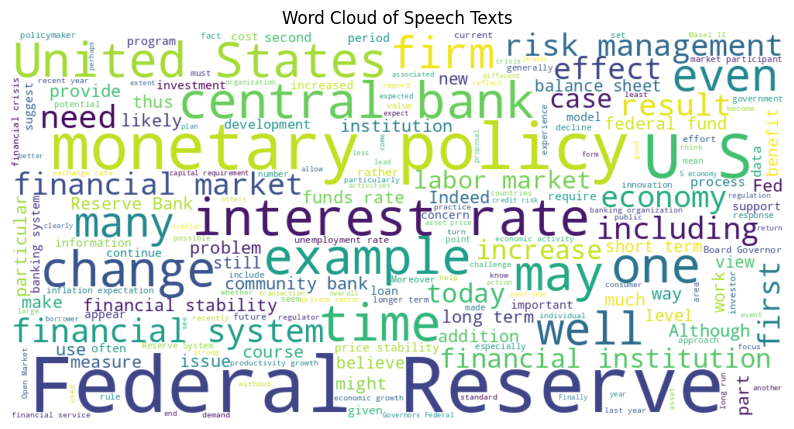

In [122]:
# Generate a Word Cloud
wordcloud = WordCloud(width=1000, height=500,
                      background_color='white',
                      colormap = 'viridis_r').generate(filtered_words)
plt.figure(figsize=(10, 6))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud of Speech Texts')
plt.show()

among the obvious financial and economic jargon we can spot words that determine the sentiment. words like change, firm, concern, risk, benefit and increase can hint what is the sentiment. In addtion, words like labor, funds rate, unemployment rate or financial stability can hint what is the main topoic that keeping the board of governors busy.